# Approximation to Friedman's five dimension function

In [1]:
import warnings

import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import pymc as pm
import pymc_bart as pmb

warnings.simplefilter(action="ignore", category=FutureWarning)

In [2]:
RANDOM_SEED = 4579
np.random.seed(RANDOM_SEED)
az.style.use("arviz-white")
plt.rcParams["figure.dpi"] = 300

## Data generation

In [3]:
X = np.random.uniform(low=0, high=1.0, size=(100, 1000))
f_x = (
    10 * np.sin(np.pi * X[:, 0] * X[:, 1])
    + 20 * (X[:, 2] - 0.5) ** 2
    + 10 * X[:, 3]
    + 5 * X[:, 4]
)
Y = np.random.normal(f_x, 1)

## Different number of variables (1)  

Testing 5, 10, 100 and, 1000 covariables, with `num_particles=60`, `chains=4`, default `tune`for 5 and 10 covariables and `tune=2000` for 100 and 1000 covariables.

In [4]:
num_covariables = ["5", "10", "100", "1000"]
idatas_60 = {}
all_trees_60 = {}
VIs_60 = []
for num_covariable, tn, pn in zip(
    num_covariables, (1000, 1000, 2000, 2000), (60, 60, 60, 60)
):
    with pm.Model() as model:
        σ = pm.HalfNormal("σ", 1)
        μ = pmb.BART("μ", X[:, : int(num_covariable)], Y, m=200)
        y = pm.Normal("y", mu=μ, sigma=σ, observed=Y)
        idata = pm.sample(
            tune=tn,
            chains=4,
            random_seed=RANDOM_SEED,
            step=[pmb.PGBART([μ], num_particles=pn)],
        )
        idatas_60[num_covariable] = idata
        all_trees_60[num_covariable] = μ
        VI = idata.sample_stats["variable_inclusion"].mean(("chain", "draw")).values
        VIs_60.append(VI / VI.sum())

Multiprocess sampling (4 chains in 3 jobs)
CompoundStep
>PGBART: [μ]
>NUTS: [σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 1049 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
Multiprocess sampling (4 chains in 3 jobs)
CompoundStep
>PGBART: [μ]
>NUTS: [σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 1051 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
Multiprocess sampling (4 chains in 3 jobs)
CompoundStep
>PGBART: [μ]
>NUTS: [σ]


Sampling 4 chains for 2_000 tune and 1_000 draw iterations (8_000 + 4_000 draws total) took 1567 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
Multiprocess sampling (4 chains in 3 jobs)
CompoundStep
>PGBART: [μ]
>NUTS: [σ]


Sampling 4 chains for 2_000 tune and 1_000 draw iterations (8_000 + 4_000 draws total) took 1944 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details


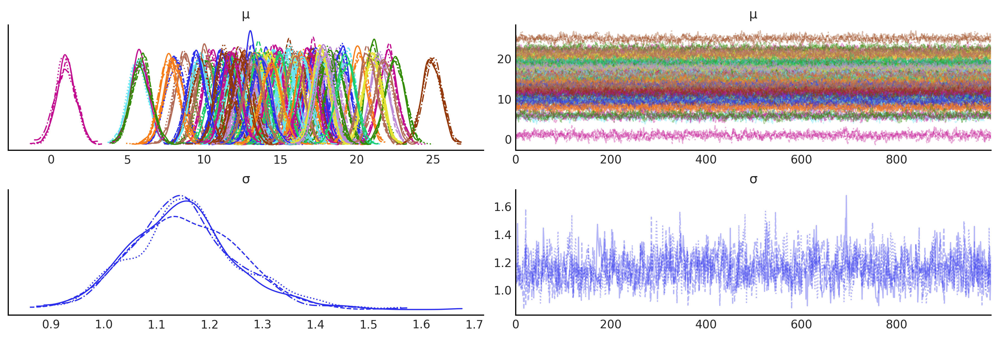

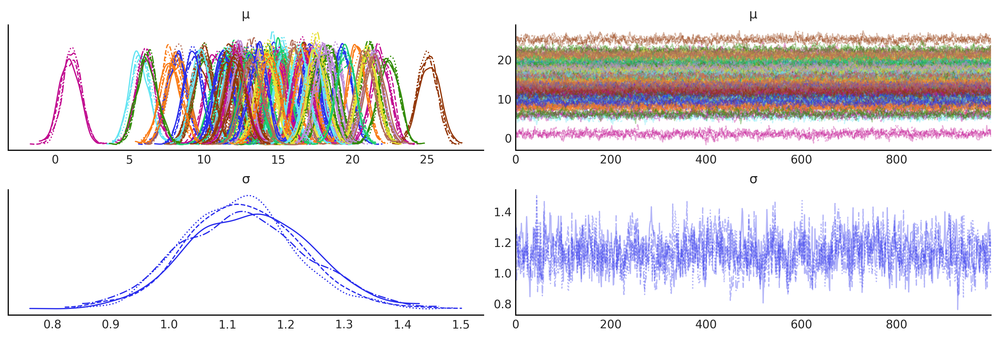

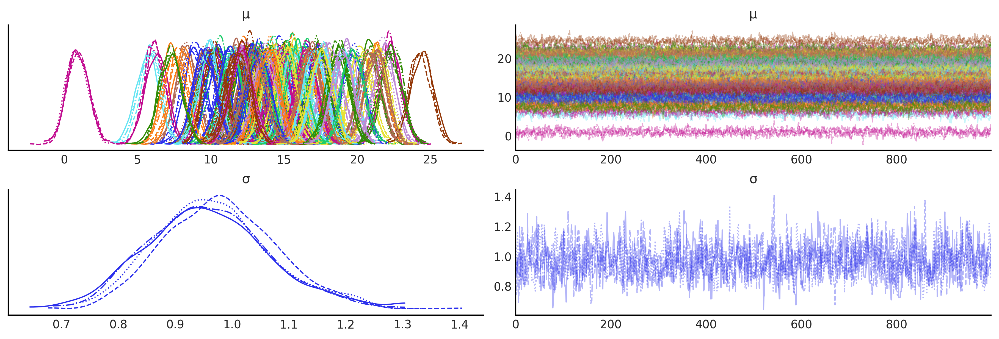

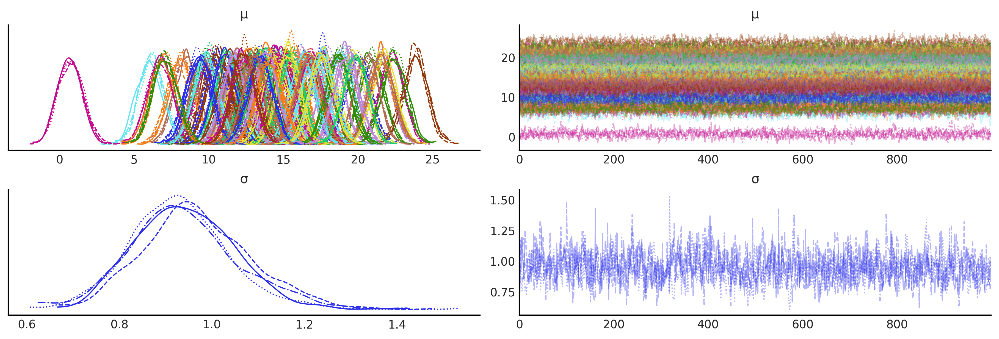

In [5]:
for num_covariable in num_covariables:
    az.plot_trace(idatas_60[num_covariable]);

In [6]:
for num_covariable in num_covariables:
    print(az.rhat(idatas_60[num_covariable]).mean().values())

ValuesView(<xarray.Dataset>
Dimensions:  ()
Data variables:
    μ        float64 1.005
    σ        float64 1.005)
ValuesView(<xarray.Dataset>
Dimensions:  ()
Data variables:
    μ        float64 1.005
    σ        float64 1.003)
ValuesView(<xarray.Dataset>
Dimensions:  ()
Data variables:
    μ        float64 1.008
    σ        float64 1.007)
ValuesView(<xarray.Dataset>
Dimensions:  ()
Data variables:
    μ        float64 1.005
    σ        float64 1.015)


In [7]:
# Out-of-sample data
X_new = np.random.uniform(low=0.0, high=1.0, size=(100, 1000))
f_x_new = (
    10 * np.sin(np.pi * X_new[:, 0] * X_new[:, 1])
    + 20 * (X_new[:, 2] - 0.5) ** 2
    + 10 * X_new[:, 3]
    + 5 * X_new[:, 4]
)
Y_new = np.random.normal(f_x_new, 1)

0.961683075012625
0.9736488354988153
0.9325251468680721
0.9530022653787287
1.7218605117463948
1.8611794431221527
2.1939303676521043
2.6668464894926864


/tmp/ipykernel_562845/2947869708.py:38: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout(h_pad=2)


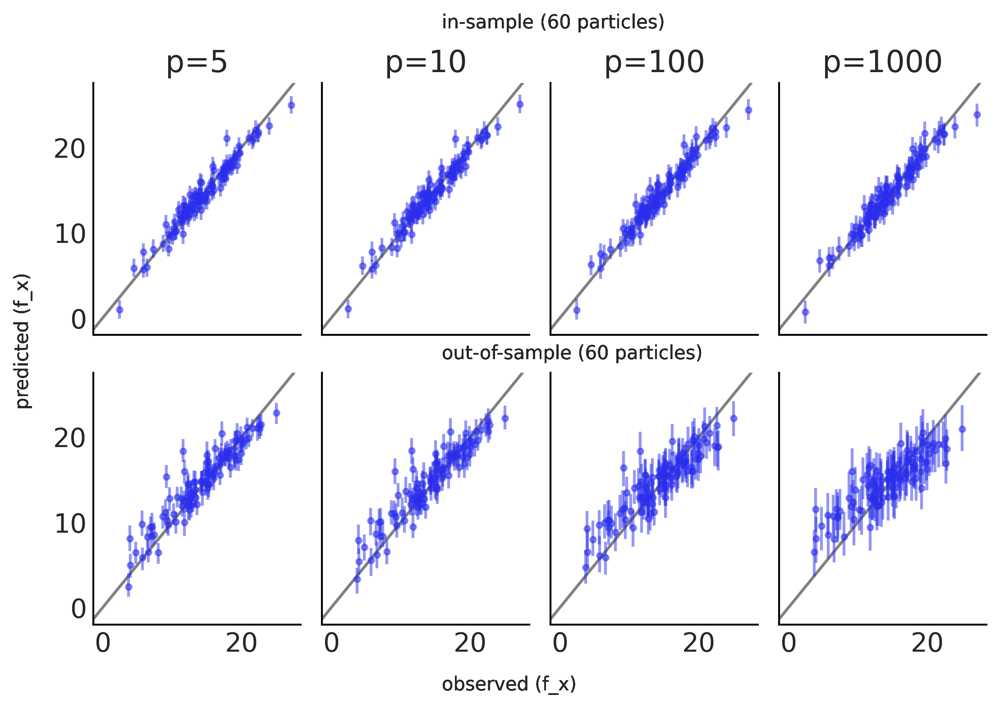

In [8]:
fig, axes = plt.subplots(2, 4, sharex=True, sharey=True)

for i, (name, ax) in enumerate(zip(num_covariables * 2, axes.ravel())):
    ax.axline([0, 0], [1, 1], color="0.5")
    if i <= 3:  # in-sample
        ax.set_title(f"p={name}")
        μs = idatas_60[name].posterior["μ"].stack(samples=["chain", "draw"])
        mean = μs.mean("samples")
        hdi = az.hdi(μs.T.values, hdi_prob=0.9)
        yerr = np.vstack([mean - hdi[:, 0], hdi[:, 1] - mean])
        ax.errorbar(f_x, mean, yerr, linestyle="None", marker=".", alpha=0.5)
        print((np.mean((f_x - mean) ** 2) ** 0.5).values)
    elif i > 3:  # Out-of-sample
        μ_pred = pmb.utils._sample_posterior(
            all_trees_60[name].owner.op.all_trees,
            X_new[:, : int(name)],
            np.random.default_rng(RANDOM_SEED),
            size=500,
        ).squeeze()
        mean = μ_pred.mean(0)
        hdi = az.hdi(μ_pred, hdi_prob=0.9)
        yerr = np.vstack([mean - hdi[:, 0], hdi[:, 1] - mean])
        ax.errorbar(
            f_x_new,
            mean,
            yerr,
            linestyle="None",
            marker=".",
            alpha=0.5,
        )
        print(np.mean((f_x_new - mean) ** 2) ** 0.5)

    fig.text(0.42, 1.0, "in-sample (60 particles)")
    fig.text(0.42, 0.49, "out-of-sample (60 particles)")
    fig.text(0.42, -0.02, "observed (f_x)")
    fig.text(-0.02, 0.42, "predicted (f_x)", rotation=90)

fig.tight_layout(h_pad=2)
plt.savefig("friedman_covar_in-out_sample_tune-part60.png", bbox_inches="tight")

/home/pablo/anaconda3/envs/bart-experiments/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/pablo/anaconda3/envs/bart-experiments/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


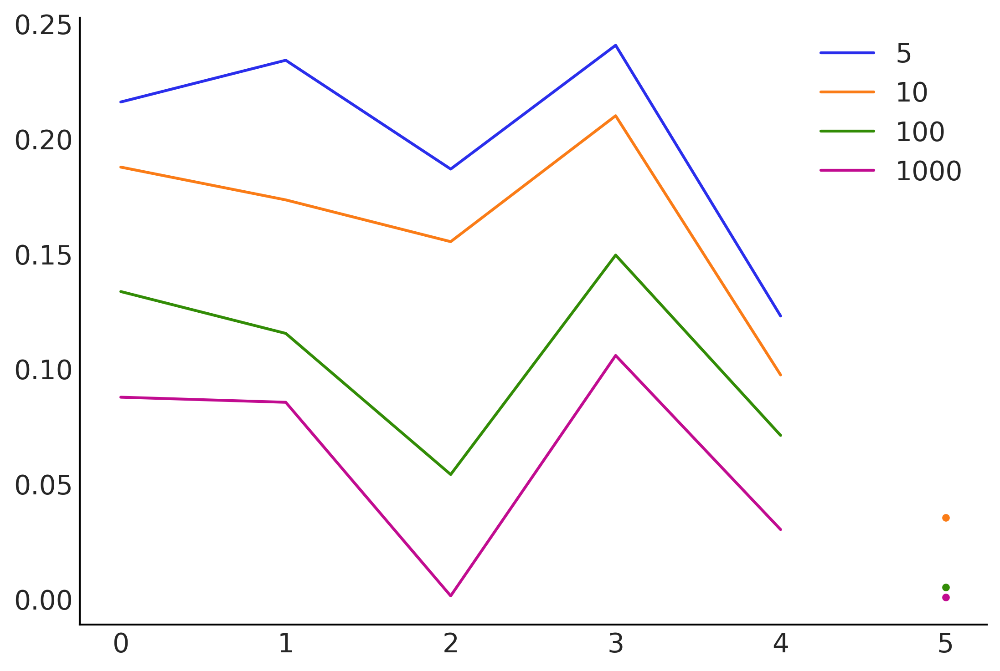

In [9]:
for idx, (VI, num_covariable) in enumerate(zip(VIs_60, num_covariables)):
    plt.plot(VI[:5], label=num_covariable, color=f"C{idx}")
    plt.plot(5, np.mean(VI[5:]), ".")
plt.legend()
plt.savefig("friedman_VI_tune-part60.png")

<Figure size 2160x1440 with 0 Axes>

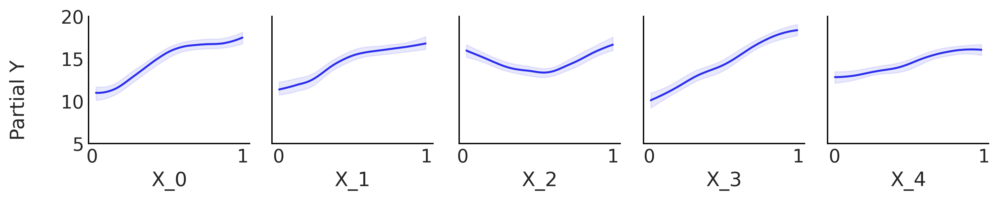

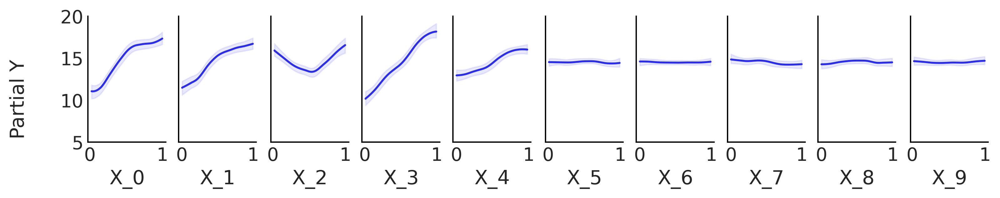

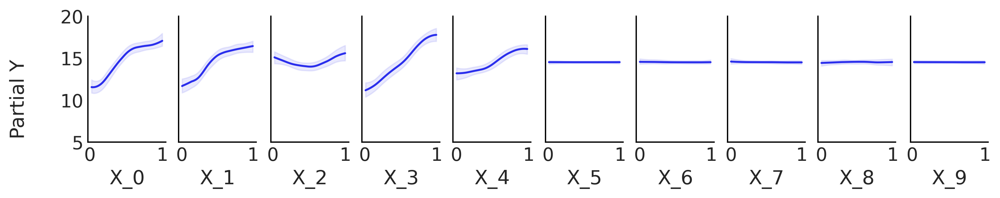

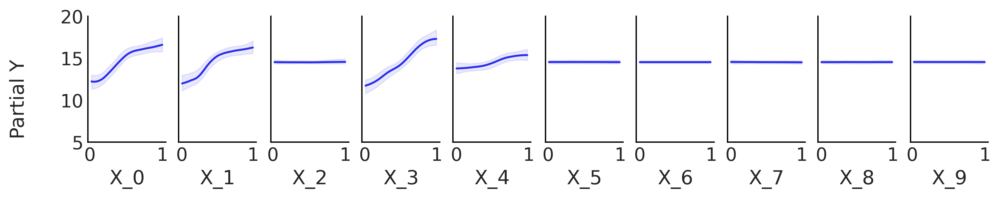

In [10]:
lim = [5, 10, 10, 10]

fig = plt.figure()

for num, l in zip(num_covariables, lim):
    var_id = range(min(10, int(num)))
    pmb.plot_pdp(all_trees_60[num], X, Y, var_idx=var_id, grid=(1, l), figsize=(10, 2))
    plt.ylim(5, 20)
    plt.savefig(f"pdps_friedman_{num}_tune-part60.png", bbox_inches="tight")

## Different number of variables (2)  

Testing 5, 10, 100 and, 1000 covariables, with `num_particles=30`, `chains=4`, and default `tune`for all covariables.

In [11]:
idatas_30 = {}
all_trees_30 = {}
VIs_30 = []
for num_covariable, tn, pn in zip(
    num_covariables, (1000, 1000, 1000, 1000), (30, 30, 30, 30)
):
    with pm.Model() as model:
        σ = pm.HalfNormal("σ", 1)
        μ = pmb.BART("μ", X[:, : int(num_covariable)], Y, m=200)
        y = pm.Normal("y", mu=μ, sigma=σ, observed=Y)
        idata = pm.sample(
            tune=tn,
            chains=4,
            random_seed=RANDOM_SEED,
            step=[pmb.PGBART([μ], num_particles=pn)],
        )
        idatas_30[num_covariable] = idata
        all_trees_30[num_covariable] = μ
        VI = idata.sample_stats["variable_inclusion"].mean(("chain", "draw")).values
        VIs_30.append(VI / VI.sum())

Multiprocess sampling (4 chains in 3 jobs)
CompoundStep
>PGBART: [μ]
>NUTS: [σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 608 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
Multiprocess sampling (4 chains in 3 jobs)
CompoundStep
>PGBART: [μ]
>NUTS: [σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 611 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
Multiprocess sampling (4 chains in 3 jobs)
CompoundStep
>PGBART: [μ]
>NUTS: [σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 624 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
Multiprocess sampling (4 chains in 3 jobs)
CompoundStep
>PGBART: [μ]
>NUTS: [σ]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 758 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details


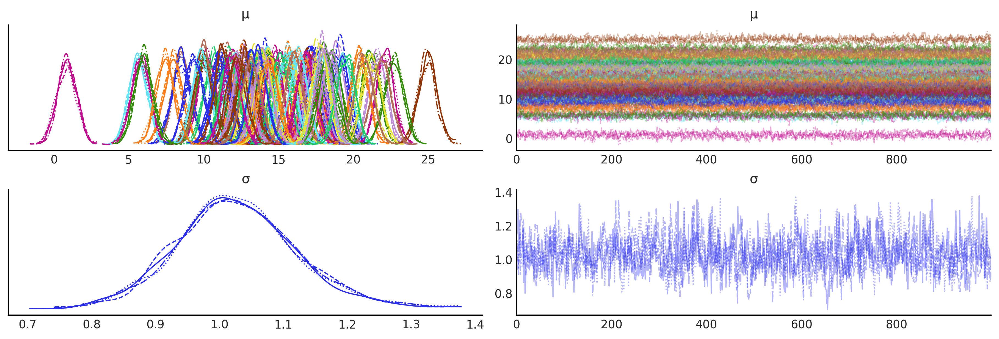

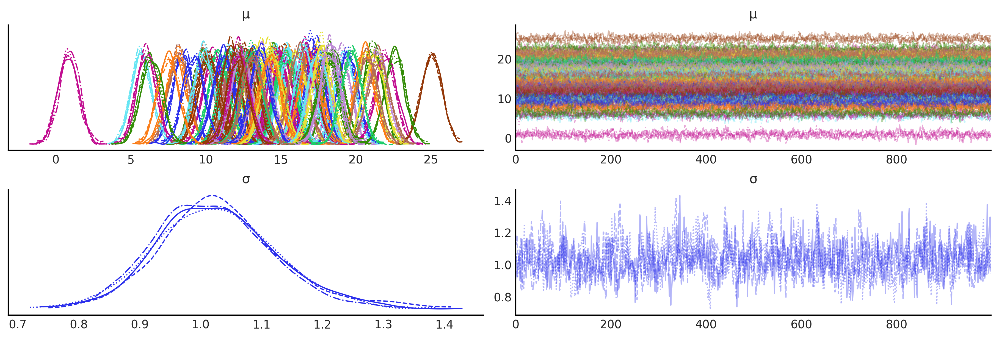

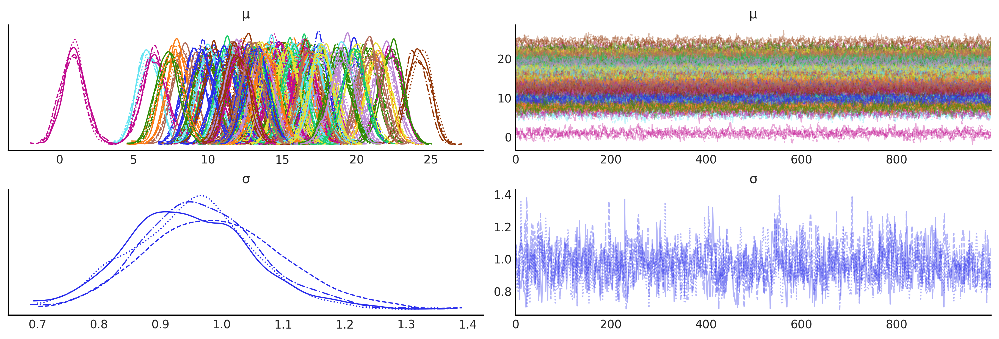

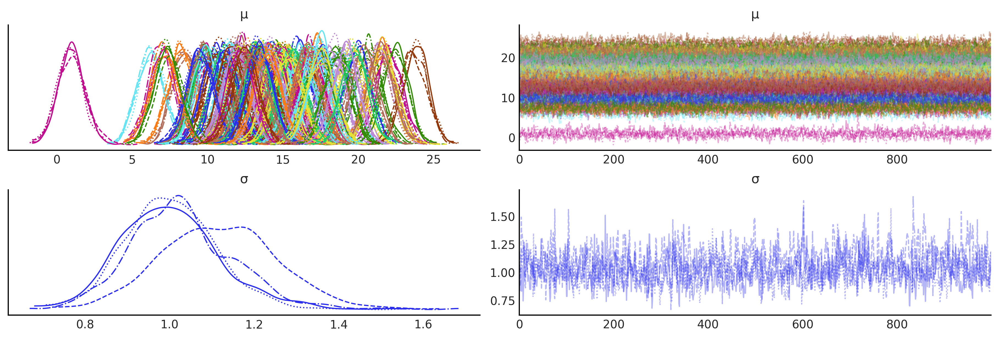

In [14]:
for num_covariable in num_covariables:
    az.plot_trace(idatas_30[num_covariable]);

In [12]:
for num_covariable in num_covariables:
    print(az.rhat(idatas_30[num_covariable]).mean().values())

ValuesView(<xarray.Dataset>
Dimensions:  ()
Data variables:
    μ        float64 1.004
    σ        float64 1.001)
ValuesView(<xarray.Dataset>
Dimensions:  ()
Data variables:
    μ        float64 1.004
    σ        float64 1.005)
ValuesView(<xarray.Dataset>
Dimensions:  ()
Data variables:
    μ        float64 1.007
    σ        float64 1.017)
ValuesView(<xarray.Dataset>
Dimensions:  ()
Data variables:
    μ        float64 1.007
    σ        float64 1.084)


0.881072664103407
0.9125359020876554
0.9537083278292084
0.9659892425105968
1.7045647960575663
1.8684319354300083
2.368527994615769
2.944607762551302


/tmp/ipykernel_562845/2754380076.py:38: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout(h_pad=2)


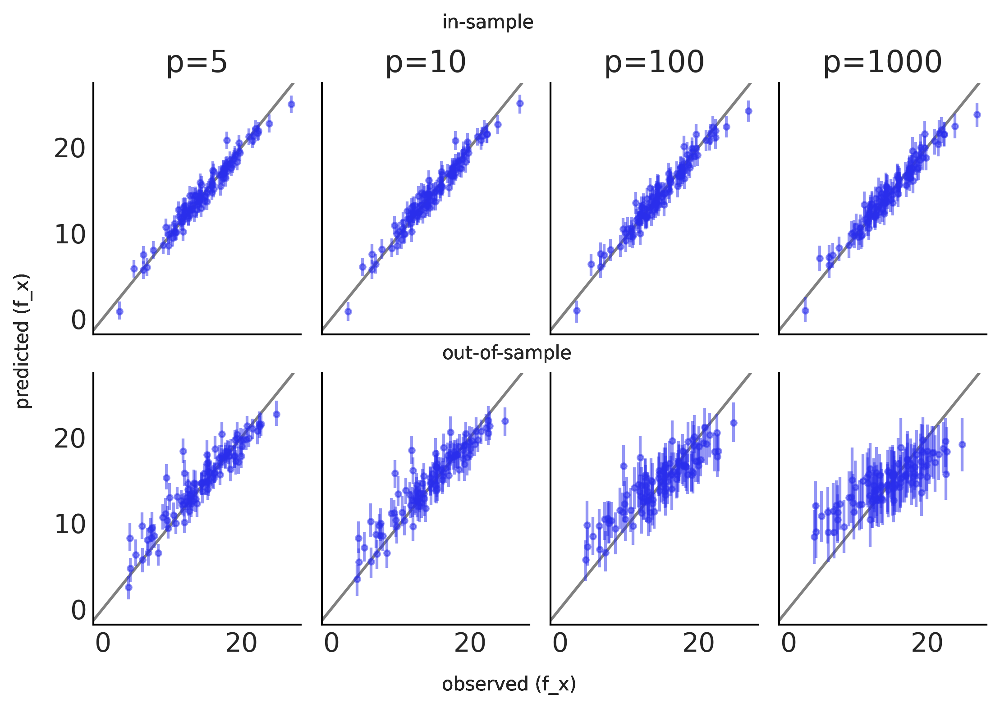

In [13]:
fig, axes = plt.subplots(2, 4, sharex=True, sharey=True)

for i, (name, ax) in enumerate(zip(num_covariables * 2, axes.ravel())):
    ax.axline([0, 0], [1, 1], color="0.5")
    if i <= 3:  # in-sample
        ax.set_title(f"p={name}")
        μs = idatas_30[name].posterior["μ"].stack(samples=["chain", "draw"])
        mean = μs.mean("samples")
        hdi = az.hdi(μs.T.values, hdi_prob=0.9)
        yerr = np.vstack([mean - hdi[:, 0], hdi[:, 1] - mean])
        ax.errorbar(f_x, mean, yerr, linestyle="None", marker=".", alpha=0.5)
        print((np.mean((f_x - mean) ** 2) ** 0.5).values)
    elif i > 3:  # Out-of-sample
        μ_pred = pmb.utils._sample_posterior(
            all_trees_30[name].owner.op.all_trees,
            X_new[:, : int(name)],
            np.random.default_rng(RANDOM_SEED),
            size=500,
        ).squeeze()
        mean = μ_pred.mean(0)
        hdi = az.hdi(μ_pred, hdi_prob=0.9)
        yerr = np.vstack([mean - hdi[:, 0], hdi[:, 1] - mean])
        ax.errorbar(
            f_x_new,
            mean,
            yerr,
            linestyle="None",
            marker=".",
            alpha=0.5,
        )
        print(np.mean((f_x_new - mean) ** 2) ** 0.5)

    fig.text(0.42, 1.0, "in-sample")
    fig.text(0.42, 0.49, "out-of-sample")
    fig.text(0.42, -0.02, "observed (f_x)")
    fig.text(-0.02, 0.42, "predicted (f_x)", rotation=90)

fig.tight_layout(h_pad=2)
plt.savefig("friedman_covar_in-out_sample_tune-part30.png", bbox_inches="tight")

/home/pablo/anaconda3/envs/bart-experiments/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/pablo/anaconda3/envs/bart-experiments/lib/python3.9/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


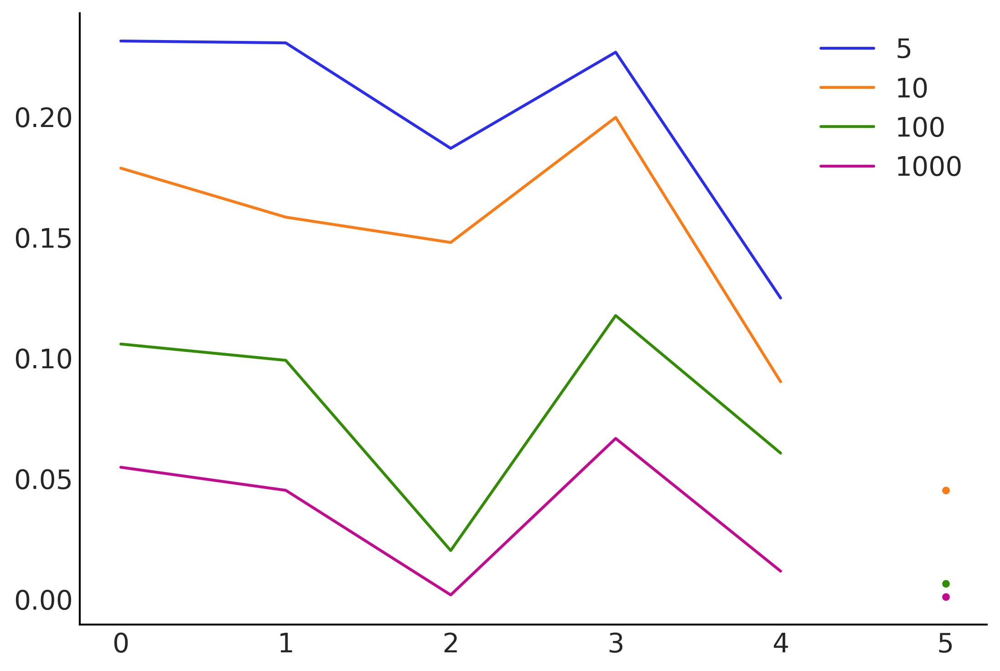

In [15]:
for idx, (VI, num_covariable) in enumerate(zip(VIs_30, num_covariables)):
    plt.plot(VI[:5], label=num_covariable, color=f"C{idx}")
    plt.plot(5, np.mean(VI[5:]), ".")
plt.legend()
plt.savefig("friedman_VI_tune-part30.png")

<Figure size 2160x1440 with 0 Axes>

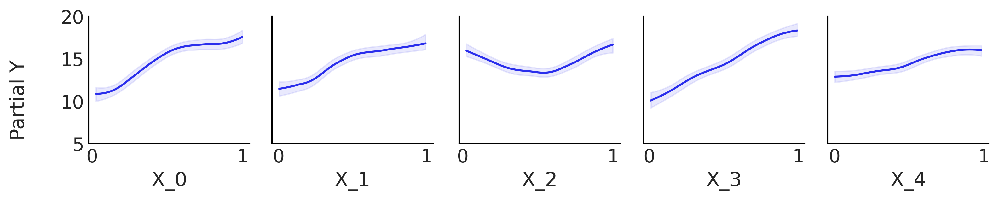

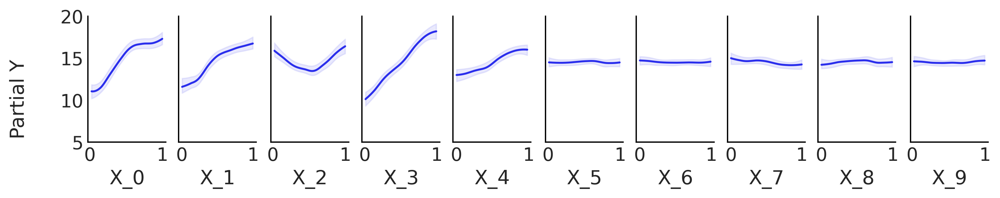

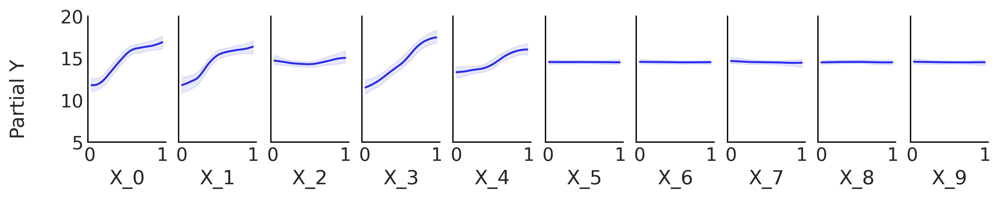

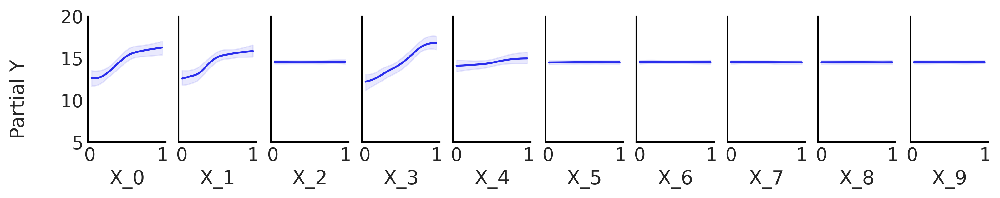

In [18]:
lim = [5, 10, 10, 10]

fig = plt.figure()

for num, l in zip(num_covariables, lim):
    var_id = range(min(10, int(num)))
    pmb.plot_pdp(all_trees_30[num], X, Y, var_idx=var_id, grid=(1, l), figsize=(10, 2))
    plt.ylim(5, 20)
    plt.savefig(f"pdps_friedman_{num}_tune-part30.png", bbox_inches="tight");